In [10]:
import numpy as np 
import shutil 
import os 
import pandas as pd 
from tqdm import tqdm 
import matplotlib.pyplot as plt 
import cv2

In [13]:
IMG_RESIZE = 1024
IMG_RESIZE_SHAPE = (IMG_RESIZE, IMG_RESIZE)

In [5]:
with open('../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/_ReadMe.txt') as f:
    readme = f.read()
    
print(readme)

*** This is a small version of the Smartphone Image Denoising Dataset (SIDD)

The "Data" directory contains 160 images representing 160 scene instances. These images can be used for training/learning purposes.

For each image, the following is provided in one directory:

1 - Noisy Raw-RGB image (.MAT).
Black Level subtracted, normalized to [0, 1].

2 - Ground truth Raw-RGB image (.MAT).
Black Level subtracted, normalized to [0, 1].

3 - Noisy sRGB image (.PNG).
Gamma corrected, without any tone mapping.

4 - Ground truth sRGB image (.PNG), gamma corrected, without any tone mapping.
Gamma corrected, without any tone mapping.

5 - Metadata extracted from the DNG file (.MAT).
For example, black and saturation levels, as-shot neutral, noise level function, etc.

So, the total number of files in the "Data" directory is 160 x 5 = 800.


*** Image directory naming convention:

Each image is stored in a directory with the name of the scene instance as follows:

<scene-instance-number>_<scene_n

In [6]:
with open('../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Scene_Instances.txt') as f:
    instances = f.read()
    
instances = instances.split('\n')
instances[:5]

['0001_001_S6_00100_00060_3200_L',
 '0002_001_S6_00100_00020_3200_N',
 '0003_001_S6_00100_00060_3200_H',
 '0004_001_S6_00100_00060_4400_L',
 '0005_001_S6_00100_00060_4400_N']

In [7]:
path = '../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/'

noisy_images_path = []
gt_images_path = []

for f in instances:
    images_path = path + f + '/'
    
    for g in os.listdir(images_path):
        image_path = images_path + g
        
        if 'NOISY' in image_path:
            noisy_images_path.append(image_path)
        else:
            gt_images_path.append(image_path)
            

print('TOTAL NOISY IMAGES:', len(noisy_images_path))
print('TOTAL GROUND TRUTH IMAGES:', len(gt_images_path))

TOTAL NOISY IMAGES: 160
TOTAL GROUND TRUTH IMAGES: 160


In [8]:
for i in range(0,len(noisy_images_path),20):    
    print(noisy_images_path[i])

../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/0001_001_S6_00100_00060_3200_L/NOISY_SRGB_010.PNG
../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/0023_001_N6_00800_00350_5500_N/NOISY_SRGB_010.PNG
../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/0050_002_N6_03200_03200_5500_L/NOISY_SRGB_010.PNG
../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/0077_004_G4_00100_00025_3200_N/NOISY_SRGB_010.PNG
../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/0104_005_S6_03200_01600_4400_L/NOISY_SRGB_010.PNG
../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/0129_006_GP_00100_00100_4400_N/NOISY_SRGB_010.PNG
../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/0154_007_S6_00400_00400_5500_L/NOISY_SRGB_010.PNG
../input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only/Data/0179_008_S6_03200_00800_5500_L/NOISY_SRGB_010.PNG


In [11]:
HEIGHT = [] 
WIDTH = []

for f in tqdm(noisy_images_path):
    img = cv2.imread(f)
    height, width, channels = img.shape
    
    HEIGHT.append(height)
    WIDTH.append(width)
    
print('MIN HEIGHT:', min(HEIGHT))
print('MAX HEIGHT:', max(HEIGHT))
print()
print('MIN WIDTH:', min(WIDTH))
print('MAX WIDTH:', max(WIDTH))


100%|██████████| 160/160 [01:37<00:00,  1.64it/s]

MIN HEIGHT: 2988
MAX HEIGHT: 3120

MIN WIDTH: 4032
MAX WIDTH: 5328


In [14]:
noisy_img_array = []
gt_img_array = []

for f in tqdm(noisy_images_path):
    img = cv2.imread(f)
    img = cv2.resize(img, IMG_RESIZE_SHAPE)
    
    noisy_img_array.append(img)
    
for f in tqdm(gt_images_path):
    img = cv2.imread(f)
    img = cv2.resize(img, IMG_RESIZE_SHAPE)
    
    gt_img_array.append(img)

100%|██████████| 160/160 [01:14<00:00,  2.16it/s]


In [15]:
noisy_img_array = np.array(noisy_img_array)
gt_img_array = np.array(gt_img_array)

print('NOISY IMG ARRAY:', noisy_img_array.shape)
print('GT IMG ARRAY:', gt_img_array.shape)

NOISY IMG ARRAY: (160, 1024, 1024, 3)
GT IMG ARRAY: (160, 1024, 1024, 3)


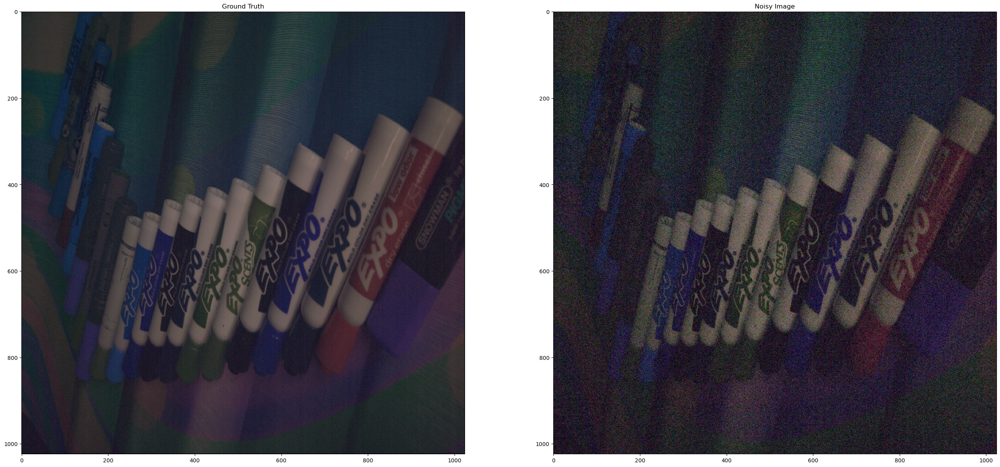

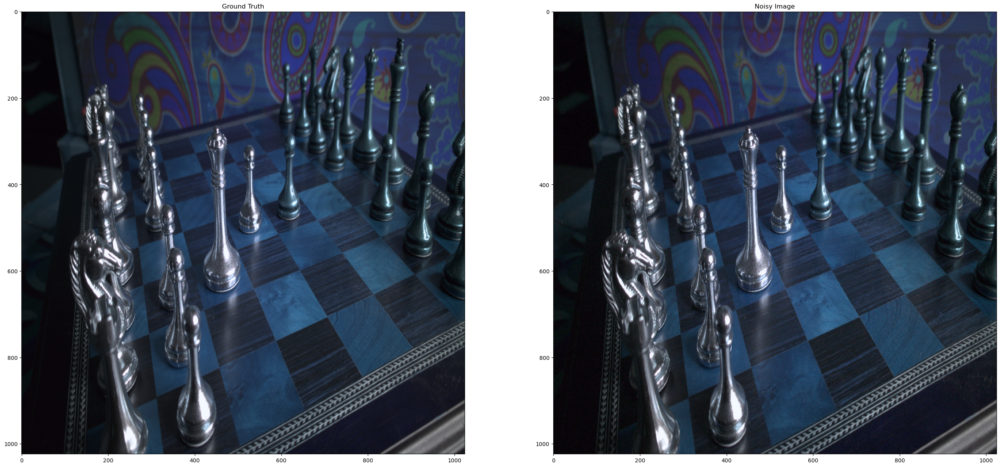

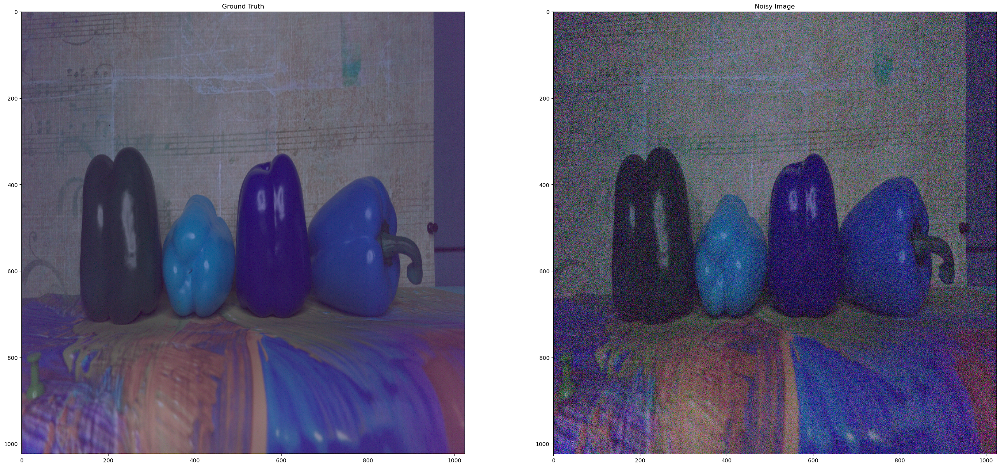

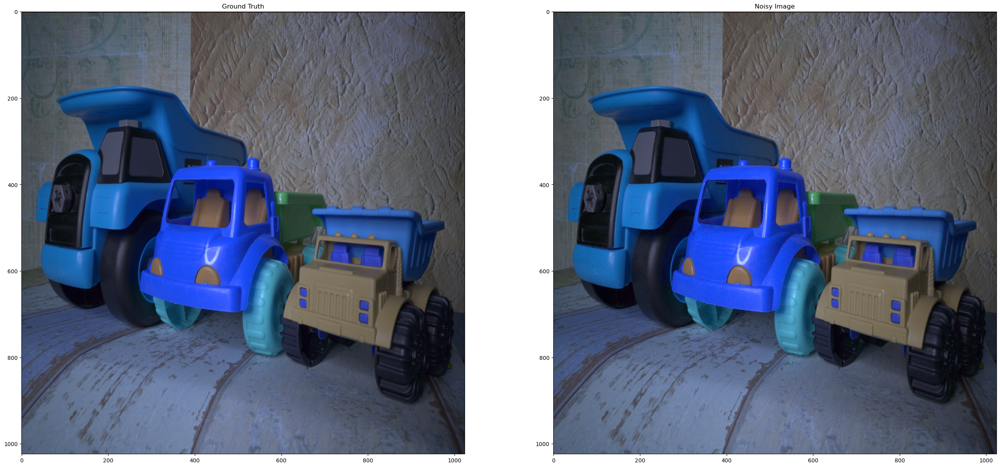

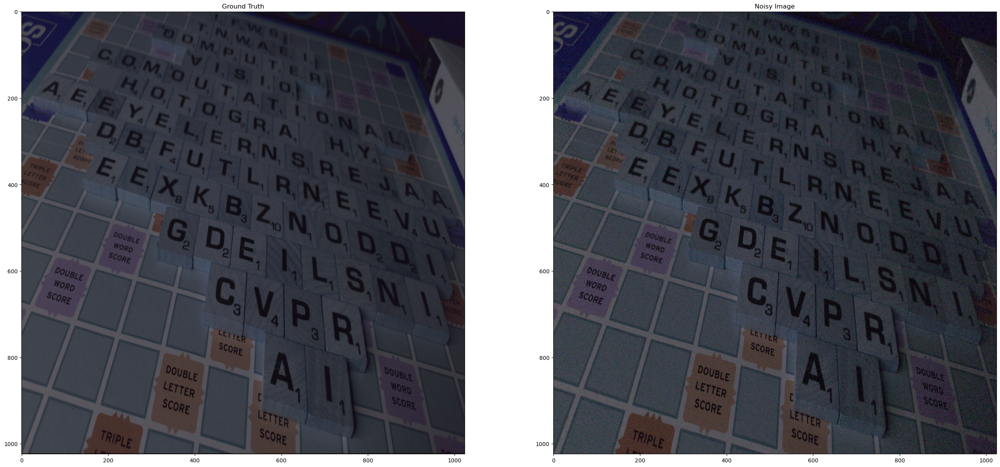

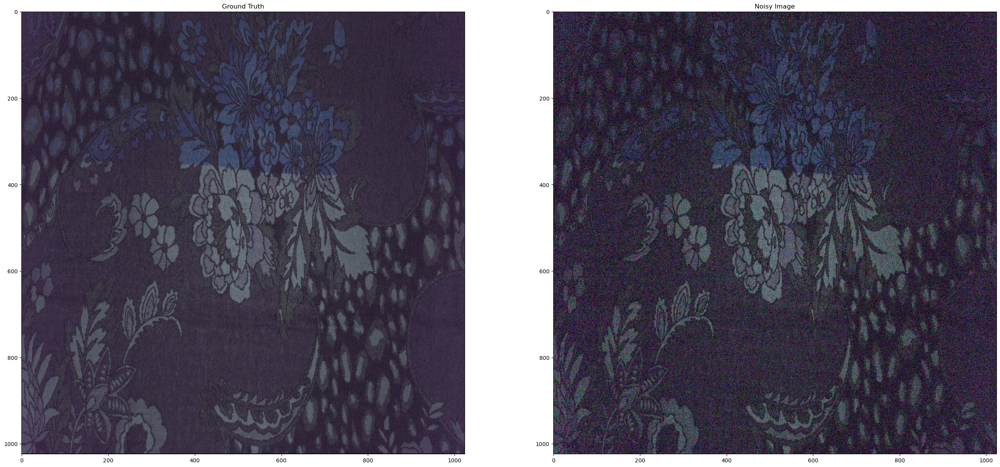

In [16]:
for i in range(0,len(noisy_img_array),20):
    
    fig=plt.figure(figsize=(50, 25))
    
    ax = plt.subplot(131)
    plt.title('Ground Truth')
    plt.imshow(gt_img_array[i])
    
    ax = plt.subplot(132)
    plt.title('Noisy Image')
    plt.imshow(noisy_img_array[i])
    plt.show()